In [89]:
!pip install pydrive2



In [90]:
data_path =data_path = r'D:\lung cancer model\Lung Cancer DS\lung_colon_image_set\lung_image_sets'

In [91]:
import numpy as np
import seaborn as sns
from tensorflow import keras
import keras
import tensorflow as tf
from matplotlib import pyplot as plt
import os
import cv2 as cv
import time
from skimage import io, measure
from scipy import ndimage
from skimage.color import label2rgb

In [92]:
def convert_seconds(seconds):
    hours = seconds // 3600
    minutes = (seconds % 3600) // 60
    seconds = seconds % 60
    return hours, minutes, seconds

In [93]:
# def show_image_samples(generated_data):
#     class_indices = generated_data.class_indices
#     class_ = list(class_indices.keys())
#     imgs, labels = generated_data.next()
#     plt.figure(figsize=(20, 20))
#     length = len(labels)
#     r = length if length < 25 else 25

#     for i in range(r):
#         plt.subplot(5, 5, i + 1)
#         plt.imshow(imgs[i], cmap='gray')
#         idx = int(labels[i])
#         c_name = classes[idx]
#         plt.title(c_name, color='Blue', fontsize=16)
#         plt.axis('off')
#     plt.show()


def show_image_samples(generated_data):
    class_indices = generated_data.class_indices
    classes = list(class_indices.keys())  # Ensure you have the correct class names
    imgs, labels = next(iter(generated_data))  # Fetch the next batch of images and labels
    plt.figure(figsize=(20, 20))
    num_samples = min(len(labels), 25)  # Display up to 25 samples

    for i in range(num_samples):
        plt.subplot(5, 5, i + 1)
        plt.imshow(imgs[i])  # No need for cmap='gray' for RGB images
        if labels.ndim > 1:  
            idx = np.argmax(labels[i])  
        else:  
            idx = int(labels[i])
        c_name = classes[idx]
        plt.title(c_name, color='blue', fontsize=16)
        plt.axis('off')

    plt.tight_layout()  # Adjust layout to avoid overlapping
    plt.show()


In [94]:
# path = '/kaggle/input/mustard-leaf-prediction/mustard-leaf-dataset'
test_path = r'D:\lung cancer model\Lung Cancer DS\lung_colon_image_set\lung_image_sets'
path = r'D:\lung cancer model\Lung Cancer DS\lung_colon_image_set\lung_image_sets'
classes = [x for x in os.listdir(path)]

classes

['adenocarcinoma', 'normal', 'squamous_cell_carcinoma']

In [95]:
def overlay(image):
    hsv = cv.cvtColor(image, cv.COLOR_BGR2HSV)
    mask = cv.inRange(hsv, (10, 30,  30), (90, 255, 255))
    closed_mask = ndimage.binary_closing(mask, np.ones((7, 7)))
    label_img = measure.label(closed_mask)
    return label2rgb(label_img, image=image)


In [96]:
def overlay():
    def green_overlay(image):
#         image = io.imread(image)
        image = image.copy()
        hsv = cv.cvtColor(image, cv.COLOR_BGR2HSV)
        mask = cv.inRange(hsv, (40, 150,  20), (90, 255, 255))
        green_objects = cv.bitwise_and(image, image, mask=mask)
        print(mask)

        return cv.cvtColor(green_objects, cv.COLOR_BGR2RGB)
    return green_overlay


In [97]:
bs = 32


In [98]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [99]:
image_gen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.25
)

test_gen = ImageDataGenerator(rescale=1./255)

In [100]:
data_train = image_gen.flow_from_directory(
    os.path.join(path),
    target_size=(224, 224),
    batch_size=bs,
    color_mode='rgb',
    classes=classes,
    subset='training',
    class_mode='categorical',
    shuffle=True
)

data_val = image_gen.flow_from_directory(
    os.path.join(path),
    target_size=(224, 224),
    batch_size=bs,
    color_mode='rgb',
    classes=classes,
    subset='validation',
    class_mode='categorical',
    shuffle=True
)

data_test = test_gen.flow_from_directory(
    test_path,
    target_size=(224, 224),
    batch_size=bs,
    color_mode='rgb',
    classes=classes,
    class_mode='categorical',
    seed=224,
    shuffle=False
)

Found 11250 images belonging to 3 classes.
Found 3750 images belonging to 3 classes.
Found 15000 images belonging to 3 classes.


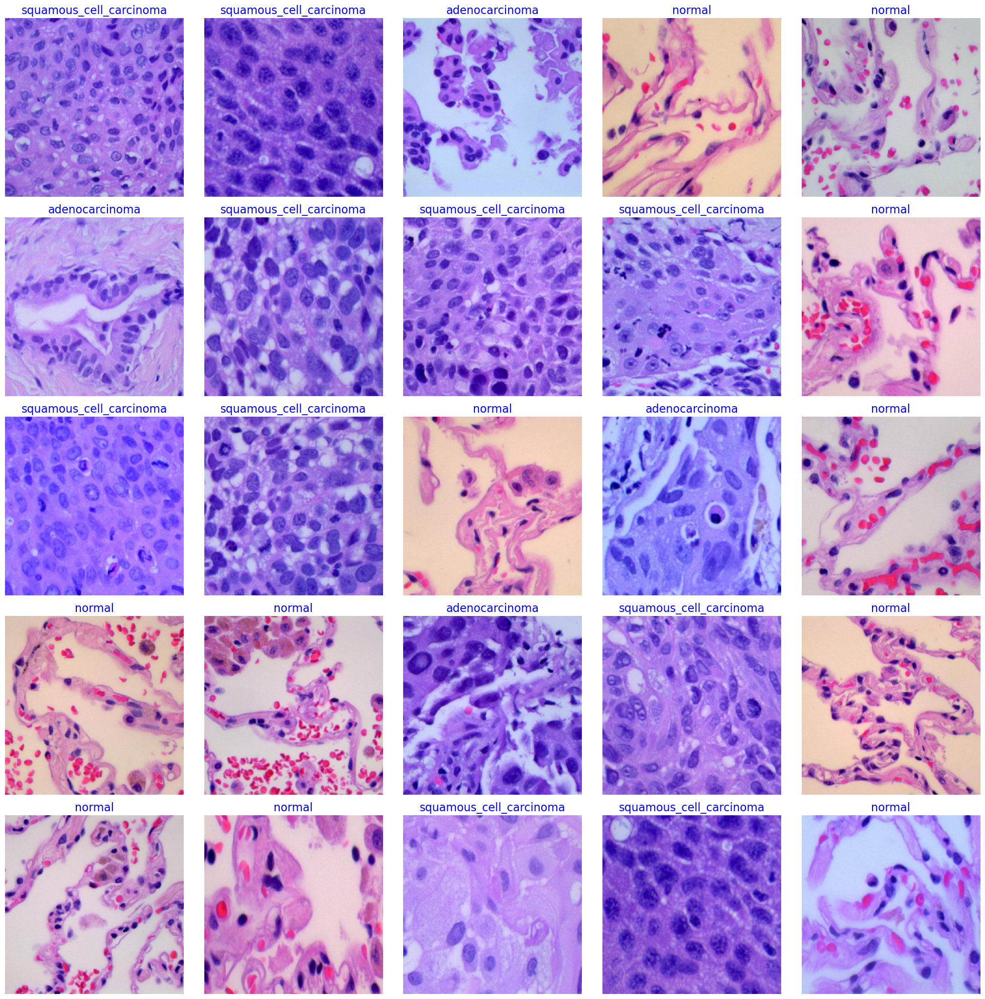

In [101]:
show_image_samples(data_train)

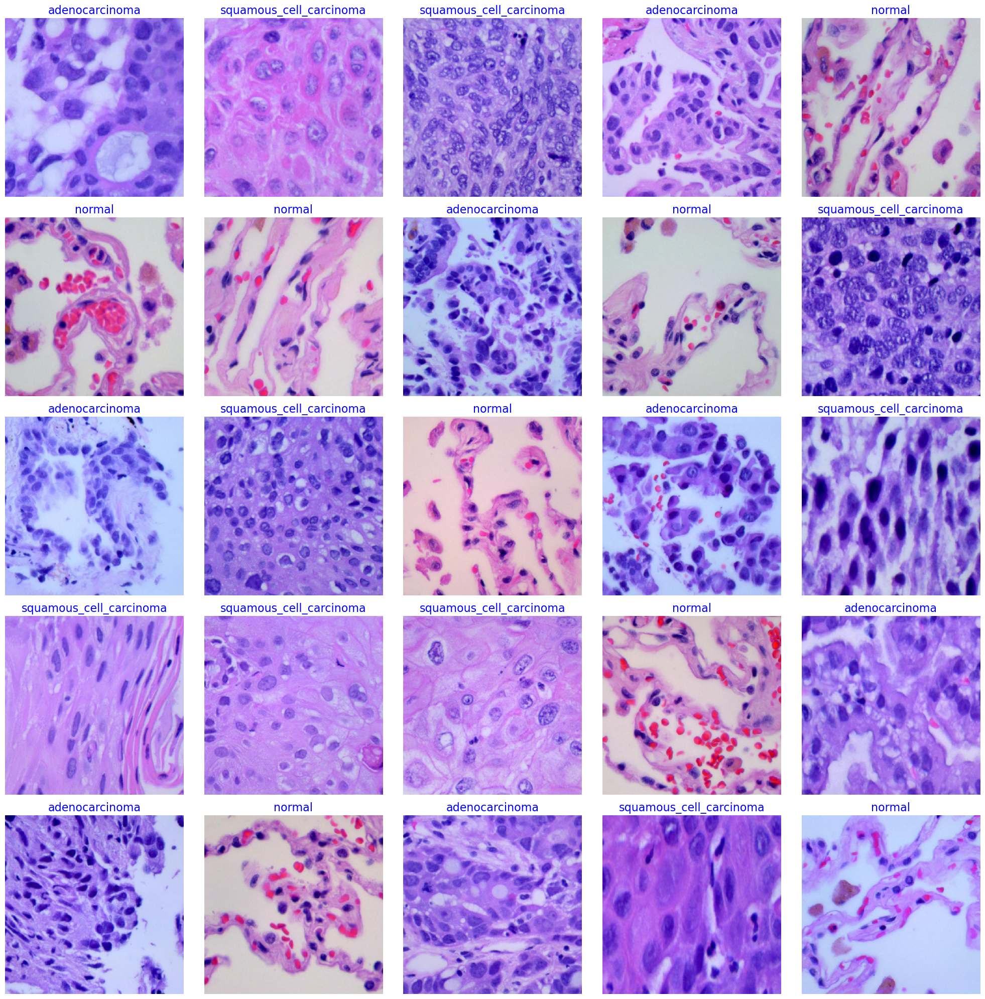

In [102]:
show_image_samples(data_val)

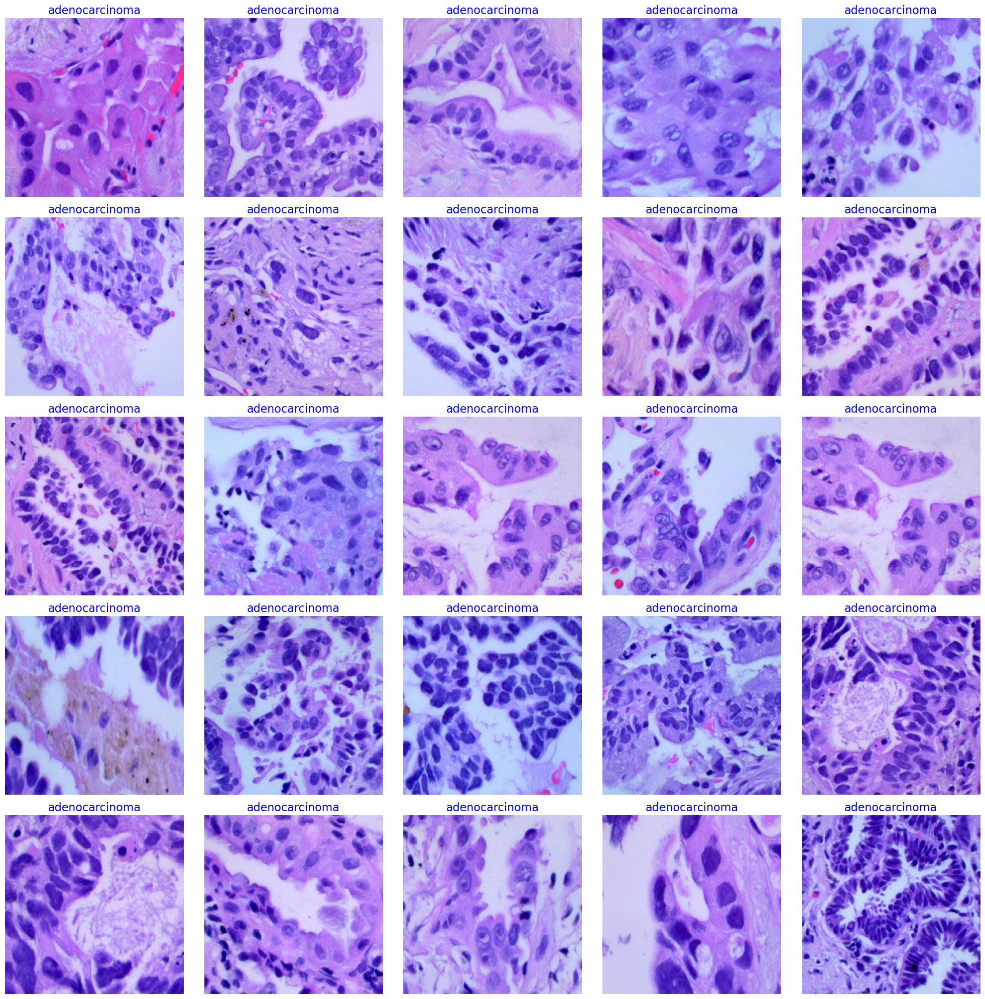

In [103]:
show_image_samples(data_test)

In [104]:
basemodel = keras.applications.VGG16(
    include_top=False,
    weights="imagenet",
    input_tensor=keras.layers.Input(shape=(224, 224, 3)),
#     pooling='max',
#     classes=len(classes),
#     classifier_activation="softmax",
)
basemodel.summary()
model = keras.models.Sequential([
    basemodel,

    keras.layers.Conv2D(32, (3, 3), activation='relu', strides=1),
    keras.layers.MaxPooling2D((2, 2)),

    keras.layers.Flatten(),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(len(classes), activation='softmax'),
])

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [105]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten

# Define the model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    Flatten(),
    Dense(3, activation='softmax')
])

In [106]:
from tensorflow.keras import optimizers

model.compile(
    loss='categorical_crossentropy',
    metrics=['accuracy'],  # Pass metrics as a list
    optimizer=optimizers.Adam(learning_rate=0.0001)
)


# model.compile(loss='sparse_categorical_crossentropy', metrics='accuracy', optimizer=keras.optimizers.Adam(learning_rate=0.0001))

In [107]:
model.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)                    │ (None, 222, 222, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_6 (Flatten)                  │ (None, 1577088)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 3)                   │       4,731,267 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,732,163 (18.05 MB)

 Trainable params: 4,732,163 (18.05 MB)

 Non-trainable params: 0 (0.00 B)

In [108]:
start_time = time.time()

In [109]:
H = model.fit(
    data_train,
    validation_data=data_val,
    epochs=5
)

Epoch 1/5
352/352 ━━━━━━━━━━━━━━━━━━━━ 191s 538ms/step - accuracy: 0.8131 - loss: 0.6698 - val_accuracy: 0.8941 - val_loss: 0.2860
Epoch 2/5
352/352 ━━━━━━━━━━━━━━━━━━━━ 198s 564ms/step - accuracy: 0.8957 - loss: 0.2544 - val_accuracy: 0.8589 - val_loss: 0.4490
Epoch 3/5
352/352 ━━━━━━━━━━━━━━━━━━━━ 202s 573ms/step - accuracy: 0.9389 - loss: 0.1624 - val_accuracy: 0.9144 - val_loss: 0.2343
Epoch 4/5
352/352 ━━━━━━━━━━━━━━━━━━━━ 228s 647ms/step - accuracy: 0.9601 - loss: 0.1093 - val_accuracy: 0.9029 - val_loss: 0.2354
Epoch 5/5
352/352 ━━━━━━━━━━━━━━━━━━━━ 321s 913ms/step - accuracy: 0.9803 - loss: 0.0707 - val_accuracy: 0.9088 - val_loss: 0.2280


In [110]:
end_time = time.time()
h, m, s = convert_seconds(end_time - start_time)
final_time = f"{int(h)} Jam {int(m)} Menit {round(s, 3)} Detik"
final_time

'0 Jam 19 Menit 0.456 Detik'

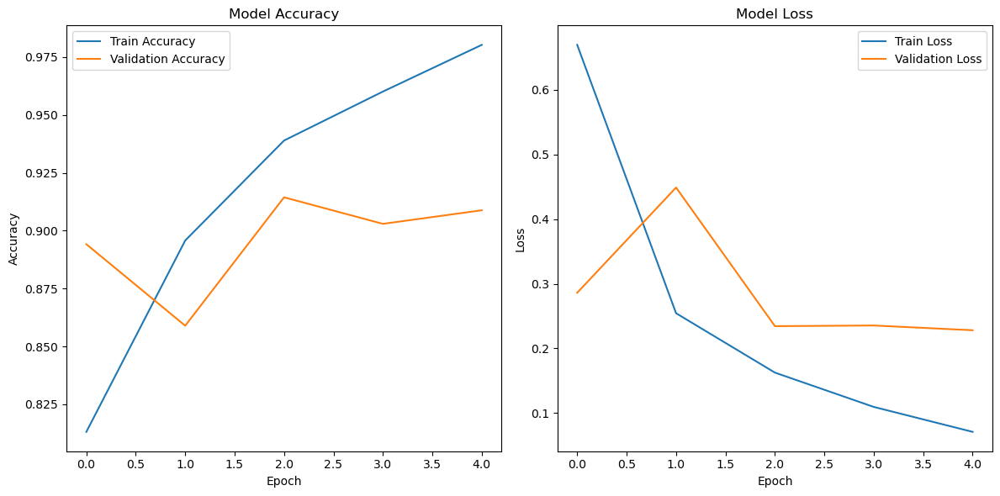

In [111]:
# plt.plot(np.arange(1, N), H.history["loss"], label="Training loss")
# plt.plot(np.arange(1, N), H.history["val_loss"], label="Validation loss")
# plt.title("Loss")
# plt.legend()
# plt.show()

import matplotlib.pyplot as plt

# Assume H is the history object returned by model.fit
# Extract the history dictionary
history = H.history

# Plot training & validation accuracy values
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Train Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [112]:
# plt.plot(np.arange(1, N), H.history["accuracy"], label="Training accuracy")
# plt.plot(np.arange(1, N), H.history["val_accuracy"], label="Validation Accuracy")
# plt.title("Accuracy Score")
# plt.legend()

# plt.show()

In [113]:
# N = 41

# fig, ax = plt.subplots(2, 1, figsize=(12, 10))
# ax = ax.flatten()

# ax[0].plot(np.arange(1, N), H.history["loss"], label="Training loss")
# ax[0].plot(np.arange(1, N), H.history["val_loss"], label="Validation loss")
# ax[0].title.set_text("Loss")
# ax[0].legend()

# ax[1].plot(np.arange(1, N), H.history["accuracy"], label="Training accuracy")
# ax[1].plot(np.arange(1, N), H.history["val_accuracy"], label="Validation Accuracy")
# ax[1].title.set_text("Accuracy Score")
# ax[1].legend()

# plt.show()

In [114]:
prediction = model.predict(data_test)

469/469 ━━━━━━━━━━━━━━━━━━━━ 173s 368ms/step


In [115]:
model.evaluate(data_test)

469/469 ━━━━━━━━━━━━━━━━━━━━ 172s 368ms/step - accuracy: 0.9747 - loss: 0.0883


[0.08831511437892914, 0.9746666550636292]

469/469 ━━━━━━━━━━━━━━━━━━━━ 171s 364ms/step


<Figure size 1000x700 with 0 Axes>

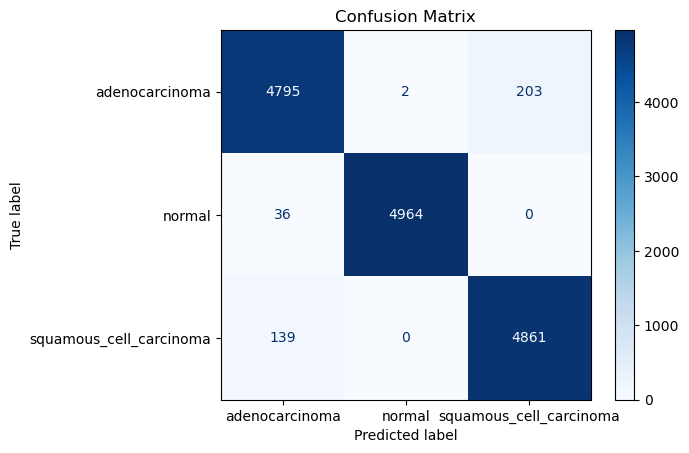

In [116]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_true = data_test.classes
y_pred = np.argmax(model.predict(data_test), axis=-1)

# Get class indices and labels
class_indices = data_test.class_indices
class_labels = sorted(class_indices, key=class_indices.get)  # Ensure consistent order

# Create a mapping from indices to class labels
index_to_label = {index: label for label, index in class_indices.items()}
y_true_labels = [index_to_label[index] for index in y_true]
y_pred_labels = [index_to_label[index] for index in y_pred]

# Compute the confusion matrix
cm = confusion_matrix(y_true_labels, y_pred_labels, labels=class_labels)

# Plot the confusion matrix
plt.figure(figsize=(10, 7))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, values_format='d')
plt.title('Confusion Matrix')
plt.show()

In [117]:
from sklearn.metrics import classification_report

report = classification_report(y_true, y_pred, target_names=class_labels, output_dict=True)
print("Classification Report:")
print(report)

Classification Report:
{'adenocarcinoma': {'precision': 0.9647887323943662, 'recall': 0.959, 'f1-score': 0.9618856569709128, 'support': 5000.0}, 'normal': {'precision': 0.999597261377366, 'recall': 0.9928, 'f1-score': 0.9961870359221353, 'support': 5000.0}, 'squamous_cell_carcinoma': {'precision': 0.959913112164297, 'recall': 0.9722, 'f1-score': 0.9660174880763116, 'support': 5000.0}, 'accuracy': 0.9746666666666667, 'macro avg': {'precision': 0.974766368645343, 'recall': 0.9746666666666667, 'f1-score': 0.9746967269897865, 'support': 15000.0}, 'weighted avg': {'precision': 0.974766368645343, 'recall': 0.9746666666666667, 'f1-score': 0.9746967269897866, 'support': 15000.0}}


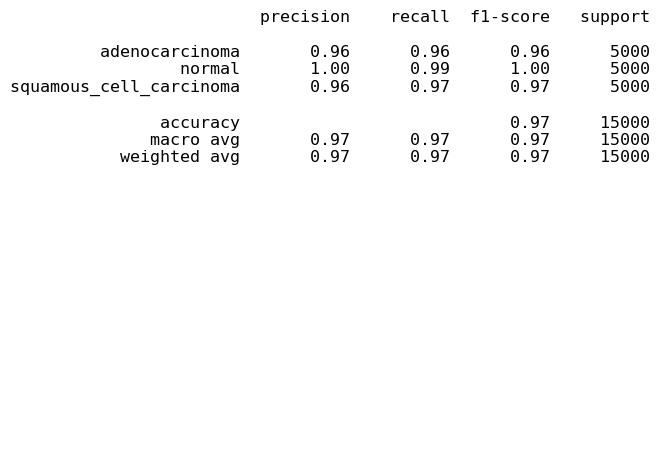

In [118]:
plt.subplot(1, 2, 2)
plt.axis('off')
report_str = classification_report(y_true, y_pred, target_names=class_labels)
plt.text(0, 1, report_str, {'fontsize': 12}, fontproperties='monospace')

# Adjust layout for better fit
plt.tight_layout()
plt.show()

In [119]:
# x=np.concatenate([data_test.next()[0] for i in range(data_test.__len__())])
# y=np.concatenate([data_test.next()[1] for i in range(data_test.__len__())])
# print(x.shape)
# print(y.shape)

In [120]:
# pred_cat = np.argmax(prediction, axis=1)


In [121]:
# f

In [122]:
# sns.heatmap(mat, cmap="BuPu", annot=True, fmt="d")
# plt.title("Confusion Matrix", size=15)
# plt.show()

In [123]:
# print(classification_report(pred_cat, y))